# Аналитика Яндекс.Афиши
Задача: помочь маркетологам снизить расходы — отказаться от невыгодных источников трафика и перераспределить бюджет.

Есть данные Яндекс.Афиши с июня 2017 по конец мая 2018 года:
* лог сервера с данными о посещениях сайта Яндекс.Афиши,
* выгрузка всех заказов за этот период,
* статистика рекламных расходов.


Нам предстоит изучить:
* как клиенты пользуются сервисом,
* когда делают первые покупки на сайте,
* сколько денег приносит компании каждый клиент,
* когда расходы на привлечение клиента окупаются.


Выручка измеряется в условных единицах — у.е.


Файл visits_log.csv хранит лог сервера с информацией о посещениях сайта, orders_log.csv — информацию о заказах, а costs.csv — информацию о расходах на маркетинг.

Структура visits_log.csv

* Uid — уникальный идентификатор пользователя,
* Device — категория устройства пользователя,
* Start Ts — дата и время начала сессии,
* End Ts — дата и время окончания сессии,
* Source Id — идентификатор источника перехода на сайт.

Структура orders_log.csv

* Uid — уникальный идентификатор пользователя,
* Buy Ts — дата и время заказа,
* Revenue — сумма заказа.

Структура costs.csv

* source_id — идентификатор рекламного источника,
* dt — дата проведения рекламной кампании,
* costs — расходы на эту кампанию.

## Загрузим данные и подготовим их к анализу


In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
visit=pd.read_csv('/datasets/visits_log.csv')
order=pd.read_csv('/datasets/orders_log.csv')
cost=pd.read_csv('/datasets/costs.csv')
list_of_data=[visit,order,cost]
for every in list_of_data:
    print('Первые 5 строк таблицы')
    print(every.head())
    print('---------------------------------------------')
    print('Общая информация по таблице')
    print(every.info())
    print('---------------------------------------------')
    

Первые 5 строк таблицы
    Device               End Ts  Source Id             Start Ts  \
0    touch  2017-12-20 17:38:00          4  2017-12-20 17:20:00   
1  desktop  2018-02-19 17:21:00          2  2018-02-19 16:53:00   
2    touch  2017-07-01 01:54:00          5  2017-07-01 01:54:00   
3  desktop  2018-05-20 11:23:00          9  2018-05-20 10:59:00   
4  desktop  2017-12-27 14:06:00          3  2017-12-27 14:06:00   

                    Uid  
0  16879256277535980062  
1    104060357244891740  
2   7459035603376831527  
3  16174680259334210214  
4   9969694820036681168  
---------------------------------------------
Общая информация по таблице
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
Device       359400 non-null object
End Ts       359400 non-null object
Source Id    359400 non-null int64
Start Ts     359400 non-null object
Uid          359400 non-null uint64
dtypes: int64(1), object(3), uint64(1)
memory usage: 13

Видим, что в таблице visit  у нас нет пропусков, но есть столбцы с датой и временем начала и окончания сессии, в которых нужно заменить тип данных. В таблице order так же нет пропусков и нужно изменить тип данных в столбце с датой и временем, можно было бы изменить тип данных в столбце с суммой заказа, но мы видим, что уже в первых 5 строках таблицы большая часть заказов на сумму меньше 1, то есть так мы потеряем важную информацию. Значит в этом столбце оставляем тип данных как есть.
В таблице cost уже можно практически безболезенно изменить тип данных в стобце с ценой на int, а также поменять тип данных в столбце с датой.
Так же для удобства переименуем некоторые столбцы.

In [2]:
visit=visit.rename(columns={'End Ts':'end_ts','Start Ts':'start_ts'})
order=order.rename(columns={'Buy Ts':'buy_ts'})
cost['costs']=cost['costs'].astype('int')
visit['end_ts']=pd.to_datetime(visit['end_ts'])
visit['start_ts']=pd.to_datetime(visit['start_ts'])
order['buy_ts']=pd.to_datetime(order['buy_ts'])
cost['dt']=pd.to_datetime(cost['dt'])

print("Число дубликатов visit:", visit.duplicated().sum())
print("Число дубликатов order:", order.duplicated().sum())
print("Число дубликатов cost:", cost.duplicated().sum())


Число дубликатов visit: 0
Число дубликатов order: 0
Число дубликатов cost: 0


Все! Данные готовы к работе. Можно приступать к следующему пункту.

P.S. тут еще конечно можно было переименоват столбцы для удобства, но поняла я это уже ближе к середине проекта, так что не стала все переделывать

## Расчитаем метрики и построим графики

### Продуктовые метрики
#### Рассчитаем DAU, WAU и MAU. Вычислим средние значения этих метрик за весь период. Отобразим изменения метрик во времени на графиках.

1.	DAU – количество уникальных пользователей в день
2.	WAU – количество уникальных пользователей в неделю 
3.	MAU – количество уникальных пользователей в месяц.


In [3]:
import plotly.express as px

visit['session_year']  = visit['start_ts'].dt.year
visit['session_month'] = visit['start_ts'].astype('datetime64[M]')
visit['session_week']  = visit['start_ts'].astype('datetime64[W]')
visit['session_date'] = visit['start_ts'].dt.date
dau_total = visit.groupby('session_date').agg({'Uid': 'nunique'}).mean()
wau_total = (
    visit.groupby(['session_year', 'session_week'])
    .agg({'Uid': 'nunique'})
    .mean()
)
mau_total = (
    visit.groupby(['session_year', 'session_month'])
    .agg({'Uid': 'nunique'})
    .mean())
print('DAU равно: ',int(dau_total))
print('WAU равно: ', int(wau_total))
print('MAU равно: ', int(mau_total))
def categorial(data,column,value):
    pivot=data.pivot_table(index=column,values=value,aggfunc='count').reset_index()
    fig=px.line(pivot,x=column,y=value,title='Зависимость '+column)
    fig.show('notebook')


DAU равно:  907
WAU равно:  5621
MAU равно:  23228


In [4]:
categorial(visit,'session_year','Uid')
categorial(visit,'session_month','Uid')
categorial(visit,'session_week','Uid')

Видно, что с каждым годом количество уникальных пользователей уменьшается, это не может не расстраивать, но мы обязательно выясним причину. Так же видно, что к середине года заметен достаточно серьезный спад посещаемости сайта, а также видно, что активность в начале года меньше, чем в конце. Это связанно с сезонностью, люди любят дарить впечатления - кино, театр, концерты, новый год - отличный повод порадовать близких + еще январские праздники, этим объясняется повышения спроса в конце и начале года. Летом спрос ниже просто потому что появляется множество других инетересных вещей для досуга, активный отдых, походы, поездки на дачу с семьей и тд. Примерно та же картина видна и в распределении по неделям, к середине года идет спад, но заметно, что он уже не такой плавный, как могло показаться. Видно, что спад случается чаще в начале месяца(13 неделя - начало апреля, 18 неделя -начало мая, 31 неделя - начало августа и тд) это может быть связно с тем, чтов начале месяца люди получают запрлату и им нужно решить первостепенные материальные вопросы - заплатить за квартиру, коммунальные услуги и так далее, а ближе к концу месяца они получают аванс и уже могут потратить его на досуг.



#### Определим, сколько раз за день пользователи в среднем заходят на сайт. Построим график, отражающий изменения метрики во времени.
Это хороший показатель регулярности использования приложения.
Чтобы найти эту метрику разделим число сессий на количество пользователей за период:


                            n_sessions  n_users  sessions_per_user
session_year session_month                                        
2017         2017-06-01          16505    13259           1.244815
             2017-07-01          17828    14183           1.256998
             2017-08-01          14355    11631           1.234202
             2017-09-01          23907    18975           1.259921
             2017-10-01          37903    29692           1.276539
             2017-11-01          43969    32797           1.340641
             2017-12-01          41983    31557           1.330386
2018         2018-01-01          36939    28716           1.286356
             2018-02-01          37182    28749           1.293332
             2018-03-01          35679    27473           1.298693
             2018-04-01          26515    21008           1.262138
             2018-05-01          26635    20701           1.286653


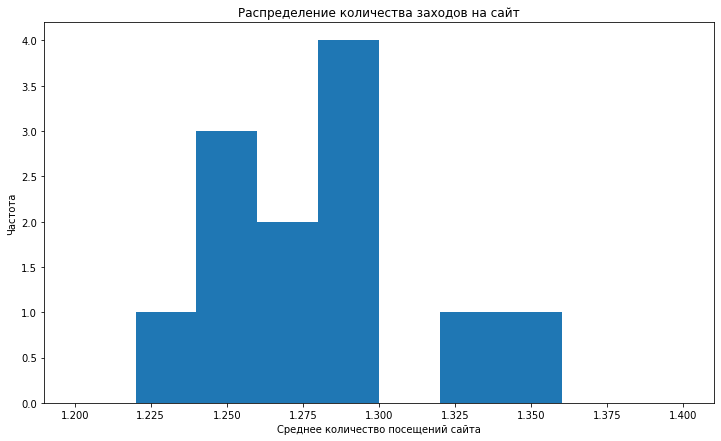

In [5]:
sessions_per_user = visit.groupby(['session_year', 'session_month']).agg(
    {'Uid': ['count', 'nunique']}
)
sessions_per_user.columns = ['n_sessions', 'n_users']
sessions_per_user['sessions_per_user'] = (
    sessions_per_user['n_sessions'] / sessions_per_user['n_users']
)
print(sessions_per_user.sort_values(by='session_month')) 
#ГРАФИК

(sessions_per_user['sessions_per_user'].plot(kind='hist',bins=10,figsize=(12,7), range=(1.2, 1.4))
                                .set(title='Распределение количества заходов на сайт',
                                    xlabel='Среднее количество посещений сайта',
                                    ylabel='Частота'))
plt.show()



In [6]:
print('Среднее число число сессий на одного пользователя: ', sessions_per_user['sessions_per_user'].mean().round(2))

Среднее число число сессий на одного пользователя:  1.28


В месяц один пользователь в среднем проводит в приложении чуть больше 1 сессии. Не сказать, что продукт используется регулярно. Это в принципе логично, человек заходит на сайт, смотрит предстоящие события, если что-то заинтересовало, смотрит билеты в кино, театр, на спортивные матчи, тут же покупает и больше в этот день на сайт не возвращается.
Средняя продолжительность сессии или ASL (англ. average session length) показывает, сколько длится сессия пользователя в среднем.

По графику видна годовая динамика изменения кол-ва сессий на 1 пользователя. Видно, что начиная с сентября этот показатель начинает расти и в ноябре достигает своего максимума - 1,34 сессия на пользователя. А в августе этот показатель минимален - 1,23. Люди чаще начинают заходить на сайт ближе к зиме, стоит это учесть распределяя бюджет на рекламу на год. 


[Text(0, 0.5, 'Количество сессий на 1 пользователя'),
 Text(0.5, 0, 'Дата'),
 Text(0.5, 1.0, 'Распределение количества заходов на сайт')]

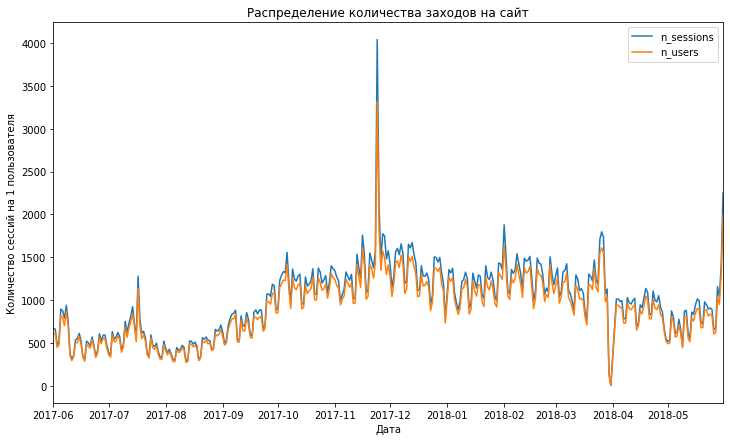

In [7]:

visit['session_date']
sessions_per_user_1=visit.groupby('session_date').agg({'Uid': ['count', 'nunique']})
sessions_per_user_1.columns = ['n_sessions', 'n_users']
sessions_per_user_1.plot(figsize=(12,7)).set(title='Распределение количества заходов на сайт',xlabel='Дата',ylabel='Количество сессий на 1 пользователя')




#### Исследуем, сколько времени пользователи проводят на сайте. Узнаем продолжительность типичной пользовательской сессии за весь период. Чтобы выбрать подходящую среднюю меру, построим график распределения. 

Среднее:  643.506488592098
Мода: 0    60
dtype: int64


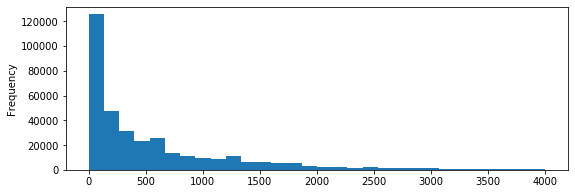

In [8]:
visit['session_duration_sec'] = (
    visit['end_ts'] - visit['start_ts']
).dt.seconds

print('Среднее: ',visit['session_duration_sec'].mean()) 
 
print('Мода:',visit['session_duration_sec'].mode())
visit['session_duration_sec'].plot(kind = 'hist', bins = 30, figsize = (9,3), range = (0, 4000))
plt.show()

Средняя продолжительность сессии - 643 секунды, распределение далеко от нормального, поэтому используем моду (значение, встречающеся чаще всего), она равна 60 секунд. 
#### Рассчитаем Retention Rate, применяя когортный анализ. Покажем изменения метрики во времени на графике. Найдем средний Retention Rate на второй месяц «жизни» когорт.

In [9]:
# чтобы построить когортный отчет, нужно определить дату и время певрой сессии каждого пользователя
first_visit=visit.groupby('Uid').agg({'start_ts':'min'}).reset_index()
first_visit.columns=['Uid','first_session_start_ts']
print(first_visit.head())
# для удобства группировкм добавим колонки даты и месяца
first_visit['first_session_dt']=first_visit['first_session_start_ts'].dt.date
first_visit['first_session_month']=first_visit['first_session_start_ts'].astype('datetime64[M]')

               Uid first_session_start_ts
0   11863502262781    2018-03-01 17:27:00
1   49537067089222    2018-02-06 15:55:00
2  297729379853735    2017-06-07 18:47:00
3  313578113262317    2017-09-18 22:49:00
4  325320750514679    2017-09-30 14:29:00


In [10]:
import numpy as np
#добавляем информацию о первом визите в датафрейм с посетителями
vis=pd.merge(first_visit, visit, on='Uid')
#считаем сколько прошло времени между каждой сессией и первой сессией пользователя
vis['age_month']=(vis['session_month']-vis['first_session_month'])/np.timedelta64(1,'M')
vis['age_month']=vis['age_month'].round().astype('int')
#когортный анализ по количеству посетителей
vis.head()

,Uid,first_session_start_ts,first_session_dt,first_session_month,Device,end_ts,Source Id,start_ts,session_year,session_month,session_week,session_date,session_duration_sec,age_month
0,11863502262781,2018-03-01 17:27:00,2018-03-01,2018-03-01,touch,2018-03-01 17:33:00,3,2018-03-01 17:27:00,2018,2018-03-01,2018-03-01,2018-03-01,360,0
1,49537067089222,2018-02-06 15:55:00,2018-02-06,2018-02-01,touch,2018-02-06 15:57:00,2,2018-02-06 15:55:00,2018,2018-02-01,2018-02-01,2018-02-06,120,0
2,297729379853735,2017-06-07 18:47:00,2017-06-07,2017-06-01,desktop,2017-06-07 18:48:00,3,2017-06-07 18:47:00,2017,2017-06-01,2017-06-01,2017-06-07,60,0
3,313578113262317,2017-09-18 22:49:00,2017-09-18,2017-09-01,desktop,2018-03-11 17:29:00,2,2018-03-11 17:23:00,2018,2018-03-01,2018-03-08,2018-03-11,360,6
4,313578113262317,2017-09-18 22:49:00,2017-09-18,2017-09-01,desktop,2017-09-18 23:07:00,2,2017-09-18 22:49:00,2017,2017-09-01,2017-09-14,2017-09-18,1080,0


In [11]:
cohorts=vis.pivot_table(index='first_session_month',
                        columns='age_month',
                        values='Uid',
                        aggfunc='nunique'
                       )
cohorts.fillna('')



age_month,0,1,2,3,4,5,6,7,8,9,10,11
first_session_month,,,,,,,,,,,,
2017-06-01,13259.0,1043,713,814,909,947,809,766,694,674,539,596
2017-07-01,13140.0,737,674,738,765,633,596,601,510,376,361,
2017-08-01,10181.0,783,640,639,510,448,370,402,284,265,,
2017-09-01,16704.0,1428,1156,847,658,632,599,404,381,,,
2017-10-01,25977.0,2042,1357,1012,890,837,555,529,,,,
2017-11-01,27248.0,2133,1202,1054,919,638,594,,,,,
2017-12-01,25268.0,1410,960,786,512,481,,,,,,
2018-01-01,22624.0,1351,890,565,458,,,,,,,
2018-02-01,22197.0,1267,565,446,,,,,,,,


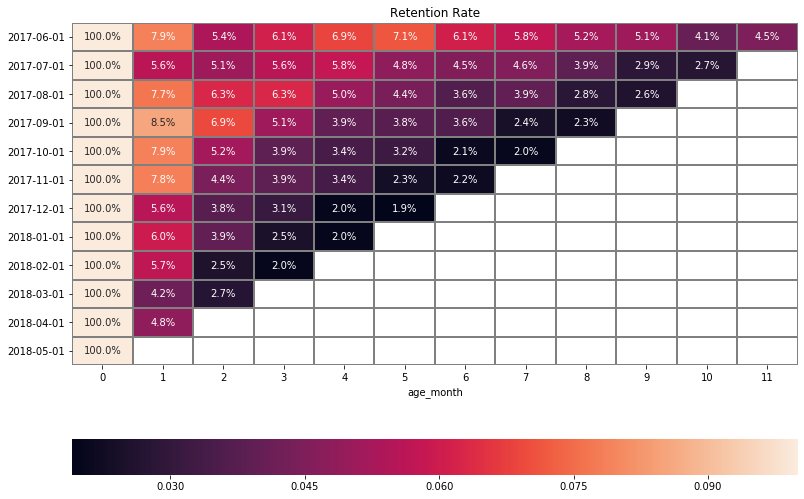

In [12]:
# рассчитаем retention Rate
retention=pd.DataFrame()
for col in cohorts.columns:
    retention=pd.concat([retention, cohorts[col]/cohorts[0]],axis=1)
retention.columns=cohorts.columns
retention.index=[str(x)[0:10] for x in retention.index]
plt.figure(figsize=(13,9))
sns.heatmap(retention, annot=True,fmt='.1%',linewidths=1,linecolor='grey',vmax=0.1,cbar_kws={'orientation':'horizontal'}
           ).set(title='Retention Rate')
plt.show()

In [13]:
print('Средний Retention Rate за второй месяц жизни когорт:', (retention[1].mean()*100).round(2))


Средний Retention Rate за второй месяц жизни когорт: 6.52


Метрика Retention Rate показывает нам сколько пользователей из когорты относительно их изачального числа вернулось в последующие периоды. За этой метрикой очень важно следить и очень важно с каждым днем ее увеличивать, ведь чем чаще клиент заходит на сайт, тем более вероятным становится то, что он совершит на сайте покупку/расскажет о нем друзьям или коллегам и приведет больше клиентов. К вам может прийти один клиент, сделать покупку на большую сумму и конечно принести вам прибыль, но ценность этого клиента с точки зрения продаж, бизнес-показателей и вашей "уверенности в завтрашнем дне" крайне мала, лучше иметь много постоянных клиентов, которые будут совершать покупки не на такие большие суммы, но приность вам постоянный доход. Именно за это отвечает Retention Rate. Мы видим, что у нас, если смотреть на наши когорты интерес к концу наблюдения за когортой теряется, а если смотртеть по первому месяцу наблюдения за когортами, то самыми лучшими месяцами по количественному показателю Retention Rate  являются осенние месяцы, а точнее с августа по ноябрь, в эти месяцы RR около 8%, что значительно выше, чем в марте или апреле. Но все же видно, что интерес к сайту теряется, ведь Retention Rate снижается с каждым месяцем наблюдения, за исключением некоторых месяцов. 
Retention Rate  на второй месяц жизни когорт меняется от 2,5% до 6,9%, выше всего он у 3-4 когорты, а ниже всего у 9-10.




### Метрики электронной коммерции
#### Исследуем, сколько времени в среднем проходит с момента первого посещения сайта до совершения покупки. 

In [14]:
# добавим день и месяц заказа, чтобы посчитать суммарную выручку за эти периоды
order['buy_dt']=order['buy_ts'].dt.date
order['order_month']=order['buy_ts'].astype('datetime64[M]')
# найдем время первой покупки каждого покупателя
first_order=order.groupby('Uid').agg({'buy_ts':'min'}).reset_index()
first_order.columns=['Uid','first_order_ts']
first_order['first_order_dt']=first_order['first_order_ts'].dt.date
first_order['first_order_month']=first_order['first_order_ts'].astype('datetime64[M]')
first_order.head()

# объединяем данные о первых покупках с данными о первых сессиях
buyer=pd.merge(first_visit,first_order,on='Uid')
buyer.head()

,Uid,first_session_start_ts,first_session_dt,first_session_month,first_order_ts,first_order_dt,first_order_month
0,313578113262317,2017-09-18 22:49:00,2017-09-18,2017-09-01,2018-01-03 21:51:00,2018-01-03,2018-01-01
1,1575281904278712,2017-06-03 10:13:00,2017-06-03,2017-06-01,2017-06-03 10:13:00,2017-06-03,2017-06-01
2,2429014661409475,2017-10-11 17:14:00,2017-10-11,2017-10-01,2017-10-11 18:33:00,2017-10-11,2017-10-01
3,2464366381792757,2018-01-27 20:10:00,2018-01-27,2018-01-01,2018-01-28 15:54:00,2018-01-28,2018-01-01
4,2551852515556206,2017-11-24 10:14:00,2017-11-24,2017-11-01,2017-11-24 10:14:00,2017-11-24,2017-11-01


In [15]:
buyer['first_order_dt']=pd.to_datetime(buyer['first_order_dt'])
buyer['first_session_dt']=pd.to_datetime(buyer['first_session_dt'])
buyer['days_to_first_purchase']=((buyer['first_order_ts']-
                                 buyer['first_session_start_ts'])/np.timedelta64(1,'D')).astype('int')
buyer.head()
print('В среднем времени проходит с первого посещения сайта до совершения покупки:', buyer['days_to_first_purchase'].mean().round(2))
print('Mode:',int(buyer['days_to_first_purchase'].mode()))
print('Max:',buyer['days_to_first_purchase'].max())

В среднем времени проходит с первого посещения сайта до совершения покупки: 16.73
Mode: 0
Max: 363


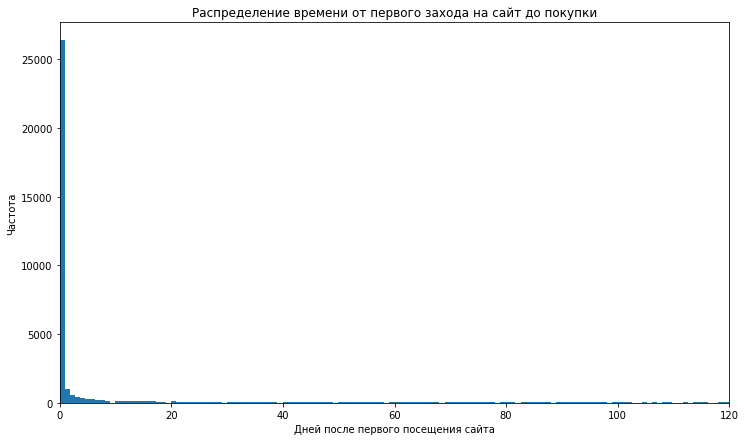

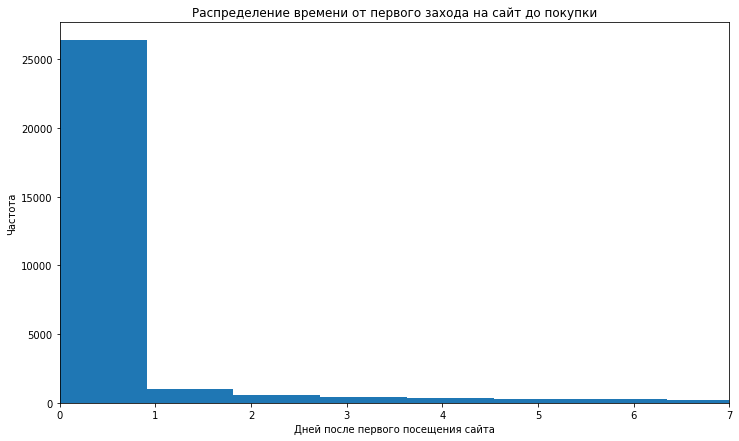

In [16]:
(buyer['days_to_first_purchase'].plot(kind='hist',bins=400,figsize=(12,7))
                                .set(title='Распределение времени от первого захода на сайт до покупки',
                                    xlabel='Дней после первого посещения сайта',
                                    ylabel='Частота'))
plt.xlim(0,120)
plt.show()
(buyer['days_to_first_purchase'].plot(kind='hist',bins=400,figsize=(12,7))
                                .set(title='Распределение времени от первого захода на сайт до покупки',
                                    xlabel='Дней после первого посещения сайта',
                                    ylabel='Частота'))
plt.xlim(0,7)
plt.show()

По расчетам видно, что в среднем с первого посещения сайта до первой покупки проходит около 17 дней, однако по графику видно, что наше распределение далеко от нормального и корректнеее было бы посчитать моду(значение встречающееся чаще всего), она равна 0, так как видно, что большая часть покупок происходит в тот же день или на следующий. Однако существуют и покупатели, у которых между первым посещением сайта и покупкой проходит больше 100 дней, максиум - 363 дня. 

#### Применяя когортный анализ или другой метод, рассчитаем среднее количество покупок на одного покупателя за определённый период, например за месяц и за год. 


In [17]:
#добавим в orders дату первого заказа и выведем в отдельный столбец месяц первого заказа
order_1=pd.merge(order,first_order, on='Uid')
order_1['first_buy_month'] = order_1['buy_ts'].astype('datetime64[M]')
order_1['first_session_month'] = order_1['first_order_dt'].astype('datetime64[M]')
order_1['buy_month'] = order_1['buy_ts'].astype('datetime64[M]')
order_1['buy_year'] = order_1['buy_ts'].dt.year
month_purchases_per_user = order_1.groupby(['buy_month', 'Uid']).agg({'buy_ts':'count'}).mean()[0]
year_purchases_per_user = order_1.groupby(['buy_year', 'Uid']).agg({'buy_ts':'count'}).mean()[0]
print('''В среднем на одного пользователя количество покупок:
В месяц - {:.2f},
В год - {:.2f}
'''.format(month_purchases_per_user, year_purchases_per_user))

В среднем на одного пользователя количество покупок:
В месяц - 1.23,
В год - 1.32



Видно, что в среднем на одного пользователя приходится в месяц всего 1,23 покупки, а в год чуть больше - 1,32. Это не так много, построим тепловую карту по когортам и количеству покупок в каждый период, чтобы понять зависит ли этот показатель от когорты или сезонности.


Text(114.0, 0.5, 'Месяц первой активности')

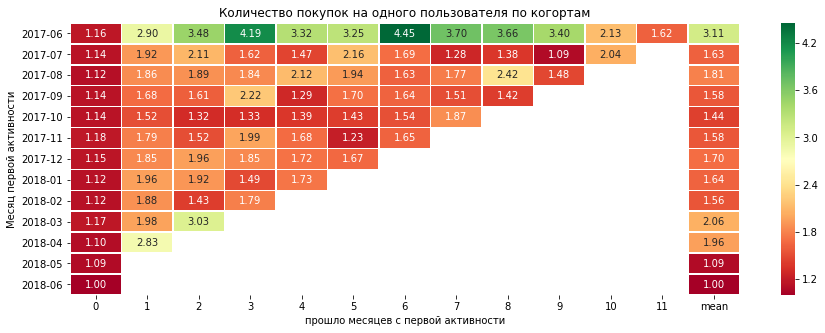

In [18]:
order_1 = order_1[['Uid', 'Revenue', 'buy_ts', 'buy_month', 'first_order_ts', 'first_order_month', 'first_session_month']]
#посчитаем lifetime заказов
order_1['lifetime_order'] = ((order_1['buy_month'] - order_1['first_session_month']) / np.timedelta64(1, 'M')).round().astype('int')

#сгруппируем заказы по когортам и lifetime и высчитаем кол-во покупок и пользователей
order_grouped_by_cohort = order_1.groupby(['first_session_month', 'lifetime_order']).agg({'Uid':['count', 'nunique']}).reset_index()
order_grouped_by_cohort.columns = ['first_session_month', 'lifetime_order', 'n_orders', 'n_users']

#получим количество заказов на одного пользователя по каждой когорте и кадлому lifetime
order_grouped_by_cohort['orders_per_user'] = order_grouped_by_cohort['n_orders'] / order_grouped_by_cohort['n_users']
order_grouped_by_cohort['first_session_month'] = order_grouped_by_cohort['first_session_month'].dt.strftime('%Y-%m')

#создадим сводную таблицу с когортным анализом количества заказов на пользователя 
cohorts_1 = order_grouped_by_cohort.pivot_table(index = 'first_session_month', columns = 'lifetime_order', values = 'orders_per_user', aggfunc = 'mean')
cohorts_1['mean'] = cohorts_1.mean(axis=1)
plt.figure(figsize=(15, 5))
plt.title('Количество покупок на одного пользователя по когортам')
sns.heatmap(cohorts_1, annot=True, fmt=".2f", linewidths=.5, cmap = 'RdYlGn')
plt.xlabel('прошло месяцев с первой активности')
plt.ylabel('Месяц первой активности')


Видно, что в первой когорте у нас самая лучшая активность по покупкам, с каждой следующей когортой снижается активность, покупок на пользователя становится все меньше, заметное отличие есть в когортах 03, 04 месяцов. Видно, что к 6 месяцу пользования сайтом у первой когорты выросло доверие или интерес, вместе с этим и вырос средний показатель по количетсву покупок, что так же опять-таки может быть связанно с сезонностью, так как 6 месяц пользования сайтом для 1 когорты - это декабрь, нужно покупать подарки близким и себе любимым. 

####  Рассчитаем средний чек, применяя группировку по времени совершения покупки.  Построим график, отражающий изменения метрики во времени;


In [19]:
mean_bill=order.groupby('order_month')['Revenue'].mean().round(2)
print(mean_bill)
import plotly.express as px
def categorial(data,column,value):
    pivot=data.pivot_table(index=column,values=value,aggfunc='mean').reset_index()
    fig=px.line(pivot,x=column,y=value,title='Зависимость '+column)
    fig.show('notebook')
categorial(order,'order_month','Revenue' )
print('Средний чек покупки ',mean_bill.mean().round(2))

order_month
2017-06-01    4.06
2017-07-01    5.31
2017-08-01    4.85
2017-09-01    5.42
2017-10-01    4.93
2017-11-01    4.78
2017-12-01    5.85
2018-01-01    4.11
2018-02-01    4.84
2018-03-01    5.41
2018-04-01    5.15
2018-05-01    4.77
2018-06-01    3.42
Name: Revenue, dtype: float64


Средний чек покупки  4.84


Видно, что средний чек очень непостоянная величина на протяжении года, однако все же можно заметить, что ближе к лету видно, что он уменьшается, начиная с марта и к середине лета уже растет. Так же заметен достаточно резкиий спад в январе.

Чек максимален в декабре и марте, а минимален в июне и январе. 


#### Выясним, как меняется LTV на покупателя по когортам. LTV — накопительная метрика. Рассчитаем средний LTV по когортам за 6 месяцев;  Маржинальность сервиса — 100%. Отразим изменения метрики во времени на графике

In [20]:
# Чтобы ответить на вопрос, построим когортный отчет от даты первой покупки
# Найдем число уникальных покупателей в каждой когорте
cohort_sizes=buyer.groupby('first_order_month').agg({'Uid':'nunique'}).reset_index()
cohort_sizes.rename(columns={'Uid':'n_buyer'},inplace=True)
cohort_sizes


,first_order_month,n_buyer
0,2017-06-01,2023
1,2017-07-01,1923
2,2017-08-01,1370
3,2017-09-01,2581
4,2017-10-01,4340
5,2017-11-01,4081
6,2017-12-01,4383
7,2018-01-01,3373
8,2018-02-01,3651
9,2018-03-01,3533


In [21]:
# Добавим в информацию о покупках месяц первой покупки
cohort=pd.merge(order,buyer,how='inner', on='Uid')\
.groupby(['first_order_month','order_month'])\
.agg({'Revenue':'sum'}).reset_index()

cohort.head()


,first_order_month,order_month,Revenue
0,2017-06-01,2017-06-01,9557.49
1,2017-06-01,2017-07-01,981.82
2,2017-06-01,2017-08-01,885.34
3,2017-06-01,2017-09-01,1931.30
4,2017-06-01,2017-10-01,2068.58


In [22]:
# считаем возраст каждой когорты
cohort['age_month']=((cohort['order_month']-cohort['first_order_month'])/np.timedelta64(1,'M')).round()
cohort.columns=['first_order_month','order_month','revenue','age_month']
# добавляем в когортный отчет количество покупателей в каджой когорте
# и считаем выручку на каждого покупателя
cohort_report=pd.merge(cohort_sizes, cohort, on='first_order_month')
cohort_report['rev_per_buyer']=cohort_report['revenue']/cohort_report['n_buyer']
cohort_report.head()

,first_order_month,n_buyer,order_month,revenue,age_month,rev_per_buyer
0,2017-06-01,2023,2017-06-01,9557.49,0.0,4.724414
1,2017-06-01,2023,2017-07-01,981.82,1.0,0.485329
2,2017-06-01,2023,2017-08-01,885.34,2.0,0.437637
3,2017-06-01,2023,2017-09-01,1931.30,3.0,0.954671
4,2017-06-01,2023,2017-10-01,2068.58,4.0,1.022531


Text(114.0, 0.5, 'Когорты')

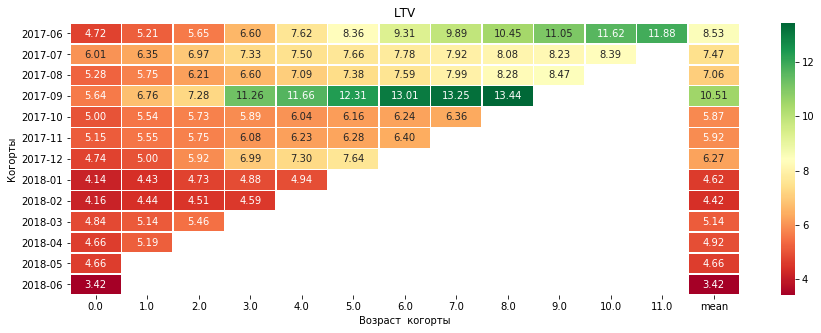

In [23]:
# возростной когортный отчет, показывающий накопительную выручку по покупателям
cohort_report['first_order_month']=cohort_report['first_order_month'].dt.strftime('%Y-%m')
cohort_age=cohort_report.pivot_table(
    index='first_order_month',
    columns='age_month',
    values='rev_per_buyer',
    aggfunc='sum'
).cumsum(axis=1)
cohort_age.round(2).fillna('')
cohort_age['mean'] = cohort_age.mean(axis=1)
plt.figure(figsize=(15, 5))
plt.title('LTV')
sns.heatmap(cohort_age, annot=True, fmt=".2f", linewidths=.5, cmap = 'RdYlGn')
plt.xlabel('Возраст  когорты')
plt.ylabel('Когорты')

Видно, что в целом показатель LTV плавнее всего растет в первой когорте, самые высокие показатели LTV наблюдаются в 4 когорте. А так же можно заметить, что в целом к концу весны LTV растет, а летом он чаще ниже всего, что далее лишь подтверждается графиком. С января по май наблюдается достаточно резкий рост, после чего ltv падает и держится примерно на одном уровне весь год. То есть больше всего денег люди приносят ближе к лету. А наибольшей ценностью обладают покупатели из 1(2017-06) и 4(2017-09) когорты, так как их ltv в среднем выше, чем у остальных.(если только 4 когорта это не выброс)

In [24]:
cohort_report_=cohort_report[['revenue','n_buyer','first_order_month']]
cohort_report_['ltv']=cohort_report_['revenue']/cohort_report_['n_buyer']
cohort_report_


import plotly.express as px
def categorial(data,column,value):
    pivot=data.pivot_table(index=column,values=value,aggfunc='mean').reset_index()
    fig=px.line(pivot,x=column,y=value,title='Зависимость '+column)
    fig.show('notebook')
categorial(cohort_report_, 'first_order_month','ltv')
#cohort_report_1['ltv'].plot(kind='line', marker='o',  fontsize=10, figsize=(15,6))

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




По графику видно, что LTV на протяжении года находится примерно на одном уровне, но начиная с января достаточно резко начинает расти вплоть до мая, LTV за этот период становится больше почти в 5 раз.



In [25]:

cohort_age_1=cohort_age.query('first_order_month<"2017-12"')
print('Средний LTV за 6 месяцев с июня 2017 по декабрь равен:',cohort_age_1['mean'].mean().round(2))

Средний LTV за 6 месяцев с июня 2017 по декабрь равен: 7.56




### Маркетинговые метрики
#### Посчитаем общую сумму расходов на маркетинг. Выясним, как траты распределены по источникам. Визуализируем изменения метрик во времени;

In [26]:
print('Суммарные рассходы:',cost['costs'].sum())

Суммарные рассходы: 327877



Суммарные рассходы за весь период и по всем источникам: 327877 у.е.


In [27]:
print('Рассходы по всем источникам:', cost.groupby('source_id')['costs'].sum())

Рассходы по всем источникам: source_id
1      20660
2      42626
3     141144
4      60900
5      51565
9       5337
10      5645
Name: costs, dtype: int64


In [28]:
# найдем первый рекламный источник, из которого пришел каждый пользователь
user=visit.sort_values('start_ts').groupby('Uid').first()
user=user[['Source Id']]
buyer=pd.merge(buyer,user,left_on='Uid',right_index=True)
buyer.head()

,Uid,first_session_start_ts,first_session_dt,first_session_month,first_order_ts,first_order_dt,first_order_month,days_to_first_purchase,Source Id
0,313578113262317,2017-09-18 22:49:00,2017-09-18,2017-09-01,2018-01-03 21:51:00,2018-01-03,2018-01-01,106,2
1,1575281904278712,2017-06-03 10:13:00,2017-06-03,2017-06-01,2017-06-03 10:13:00,2017-06-03,2017-06-01,0,10
2,2429014661409475,2017-10-11 17:14:00,2017-10-11,2017-10-01,2017-10-11 18:33:00,2017-10-11,2017-10-01,0,3
3,2464366381792757,2018-01-27 20:10:00,2018-01-27,2018-01-01,2018-01-28 15:54:00,2018-01-28,2018-01-01,0,5
4,2551852515556206,2017-11-24 10:14:00,2017-11-24,2017-11-01,2017-11-24 10:14:00,2017-11-24,2017-11-01,0,5


In [29]:
buyer_daily=buyer.groupby(['Source Id','first_order_dt']).agg({'Uid':'count'}).reset_index()
buyer_daily.rename(columns={'Uid':'n_buyer'},inplace=True)
buyer_daily['first_order_dt']=pd.to_datetime(buyer_daily['first_order_dt'])
buyer_daily.head()
cost.head()

,source_id,dt,costs
0,1,2017-06-01,75
1,1,2017-06-02,62
2,1,2017-06-03,36
3,1,2017-06-04,55
4,1,2017-06-05,57


In [30]:
cost['costs_month']=cost['dt'].astype('datetime64[M]')
cost_=pd.merge(buyer_daily,cost,left_on=['Source Id','first_order_dt'],right_on=['source_id','dt'])
cost_['cost_per_buyer']=cost_['costs']/cost_['n_buyer']
cost_.head()

,Source Id,first_order_dt,n_buyer,source_id,dt,costs,costs_month,cost_per_buyer
0,1,2017-06-01,14,1,2017-06-01,75,2017-06-01,5.357143
1,1,2017-06-02,7,1,2017-06-02,62,2017-06-01,8.857143
2,1,2017-06-03,7,1,2017-06-03,36,2017-06-01,5.142857
3,1,2017-06-04,3,1,2017-06-04,55,2017-06-01,18.333333
4,1,2017-06-05,18,1,2017-06-05,57,2017-06-01,3.166667


In [31]:
# распределение трат по источникам
cost_.groupby('source_id')['cost_per_buyer'].mean()


source_id
1      9.394046
2     16.201305
3     15.555631
4      7.245941
5      8.299249
9      6.611639
10     6.338419
Name: cost_per_buyer, dtype: float64

In [32]:
#cost_.pivot_table(index=['costs_month'],columns='source_id',values='cost_per_buyer',aggfunc='mean')
cost_.head()

,Source Id,first_order_dt,n_buyer,source_id,dt,costs,costs_month,cost_per_buyer
0,1,2017-06-01,14,1,2017-06-01,75,2017-06-01,5.357143
1,1,2017-06-02,7,1,2017-06-02,62,2017-06-01,8.857143
2,1,2017-06-03,7,1,2017-06-03,36,2017-06-01,5.142857
3,1,2017-06-04,3,1,2017-06-04,55,2017-06-01,18.333333
4,1,2017-06-05,18,1,2017-06-05,57,2017-06-01,3.166667


In [33]:
import plotly.express as px


fig = px.line(cost_.pivot_table(index = ['source_id', 'costs_month'], values = 'cost_per_buyer', aggfunc = 'mean').reset_index(), x = 'costs_month', y = 'cost_per_buyer', color = 'source_id', title = 'Распределение трат по источникам с расчетом на 1 пользователя')
fig.show()    



По графику видно, что дороже всего обходятся 2, 3 источник, остальные источники находятся примерно в одной категории по затратам, но при этом видно, что траты очень зависят от месяца. Например, количество денег, потраченное на рекламу через 4 источник до сентября находится на уровне с тратами 1 источника, а к ноябрю график спускается ниже всего и потом траты почти не поднимаютя. В то время как другие источники к ноябрю наоборот дорожают и возвращаются к привычной цене лишь к февралю. 


In [34]:
fig = px.line(cost.pivot_table(index = ['source_id', 'costs_month'], values = 'costs', aggfunc = 'mean').reset_index(), x = 'costs_month', y = 'costs', color = 'source_id', title = 'Распределение трат по источникам ')
fig.show()

In [35]:
categorial(cost, 'costs_month','costs')


По графику видно, что дороже всего нам обошелся 3 источник, при чем не просто дороже, а на порядок дороже, так же видно, что траты на этот источник сильно растут к ноябрю и после ноября не так резко снижаются. Самыми незатратными были источники - 9 и 10. Источники 2,4,5 обходятся компании примерно одинакого. Наблюдается общая динами повышения расходов на рекламу к новому году. Это логично, в это время конкуренция и спрос на товар растут примерно одинакого. Так как новый год - сезон подарков, то это возможность заработать, а это как никак наша основная цель. Но не стоит забывать, что клиенты пришедшие один раз за новогодним подарком и больше на возвращавшиеся - несут очень мало смысла и может быть траты на их привлечение не окупаются этой единовременной покупкой. 

   График суммарных расходов очень похож на график по третьему источнику, это связано с тем, что 3-ий источник один из самых популярных, поэтому он немного перетягивает внимание на себя.


#### Рассчитаем средний CAC на одного покупателя для всего проекта и для каждого источника трафика. Отразим изменения метрик на графиках
CAC - это стоимость привлечения клиента. 

In [36]:
first_activity = visit.groupby('Uid').agg({'start_ts':'min'})
first_activity.columns = ['first_activity']
visit = visit.join(first_activity, on='Uid')

print('Кол-во пользователей приходивших в сервис по разному кол-ву источников:')
print(visit.groupby('Uid').agg({'Source Id':'nunique'})['Source Id'].value_counts())

visits_sources_none = visit[['Uid', 'start_ts', 'end_ts', 'first_activity', 'Source Id']]
visits_sources_none=pd.merge(visits_sources_none,first_order,on='Uid')


Кол-во пользователей приходивших в сервис по разному кол-ву источников:
1    190449
2     28642
3      6792
4      1761
5       442
6        74
7         9
Name: Source Id, dtype: int64


Большинство пользователей приходят в сервис через какой-то один источник и совсем мало приходят в сервис с нескольких разных источников. 

In [37]:
#функция для проверки была ли совершена покупка
def what_session(row):
    if row['start_ts']<=row['first_order_ts']<=row['end_ts']:
        return True
    else:
        return False

#найдем сессии в которые совершили покупки
visits_sources_none['buy_session'] = visits_sources_none.apply(what_session, axis = 1)
def before_first_purchase(row):
    if row['start_ts'] <= row['first_order_ts']:
        return True
    else:
        return False
visits_sources_none['before_first_purchase'] = visits_sources_none.apply(before_first_purchase, axis = 1)


In [38]:
visits_purchase = visits_sources_none[visits_sources_none['buy_session'] == True]
sources_all_visits = visits_sources_none.pivot_table(index = 'Uid', columns = 'Source Id', values = 'start_ts', aggfunc = 'count')
sources_all_visits = sources_all_visits.fillna(0)
sources_all_visits = sources_all_visits.astype('int')

for i in range(1,11):
    try:
        print('Источник source_{} - используется {:.1%} пользователями'.format(i, sources_all_visits[i].mean()))
    except:
            print('Источник source_{} - используется 0.0% пользователями'.format(i))


Источник source_1 - используется 44.2% пользователями
Источник source_2 - используется 52.2% пользователями
Источник source_3 - используется 49.3% пользователями
Источник source_4 - используется 60.3% пользователями
Источник source_5 - используется 40.5% пользователями
Источник source_6 - используется 0.0% пользователями
Источник source_7 - используется 0.0% пользователями
Источник source_8 - используется 0.0% пользователями
Источник source_9 - используется 13.1% пользователями
Источник source_10 - используется 7.0% пользователями


Видно, что самым популярным источником является 4 - он используется аж 60% пользователей, на втором месте у нас 2 - 52%, потом 3 - 49%. Давайте посчитаем сумму расходов на источники привлечения клиентов. 


In [39]:

visits_sources_none['ts_month'] = visits_sources_none['start_ts'].astype('datetime64[M]')
visits_to_first_purchase = visits_sources_none[visits_sources_none['before_first_purchase'] == True]
visits_to_first_purchase_pivot = visits_to_first_purchase.pivot_table(index = 'ts_month', columns = 'Source Id', values = 'start_ts', aggfunc = 'count')
visits_to_first_purchase_pivot['visits_to_purchase'] = visits_to_first_purchase_pivot.sum(axis = 1)
visits_to_first_purchase_pivot
for i in range(1,11):
    try:
        visits_to_first_purchase_pivot[i] = visits_to_first_purchase_pivot[i] / visits_to_first_purchase_pivot['visits_to_purchase']
    except:
        0


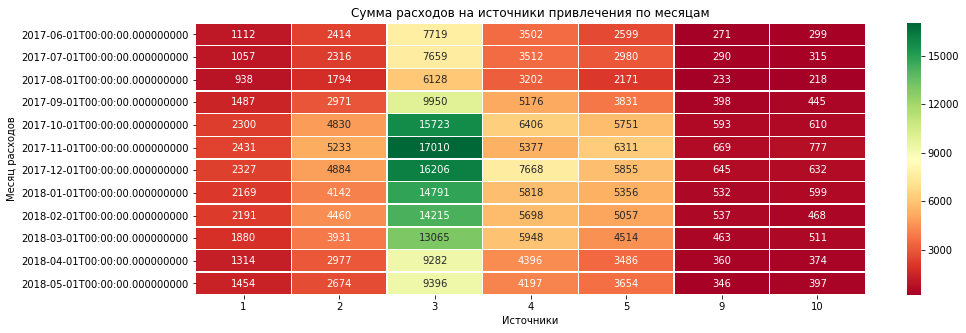

In [40]:
costs_pivot = cost.pivot_table(index = 'costs_month', columns = 'source_id', values = 'costs', aggfunc = 'sum')

plt.figure(figsize=(15, 5))
plt.title('Сумма расходов на источники привлечения по месяцам')
sns.heatmap(costs_pivot, annot=True, fmt=".0f", linewidths=.5, cmap = 'RdYlGn')
plt.xlabel('Источники')
plt.ylabel('Месяц расходов')
plt.show()

По таблице видно, что дороже всего обходится 3 источник, который находится на 3 месте по популярности. На втором месте у нас 4 источник, далее идет 5 и 2. Давайте посмотрим конверсию по источникам, чтобы понять стоит ли вкладывать так много денег в 3 источник и не стоит ли увеличить рассходы на 9 или 10.

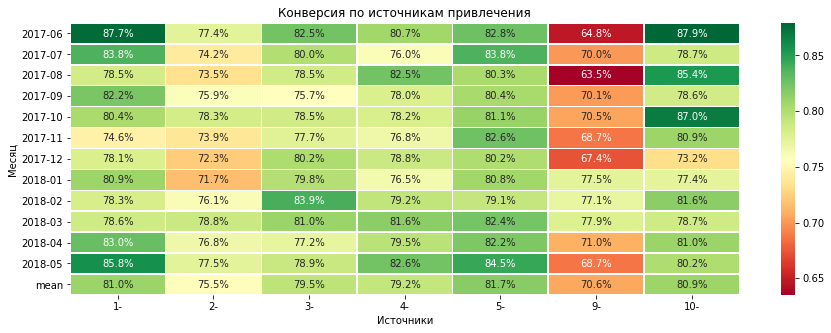

In [41]:
uid_first_source = visits_sources_none.groupby('Uid').agg({'buy_session':'sum','start_ts':'min','Source Id':'first', 'ts_month':'first'})
sources_count = uid_first_source.pivot_table(index = 'ts_month', columns = 'Source Id', values = 'buy_session', aggfunc = ['sum', 'count'])

for i in range(1, 11):
    try:
        sources_count[i] = sources_count['sum'][i] / sources_count['count'][i]
    except:
        np.nan
sources_conversion = sources_count[[1, 2, 3, 4, 5, 9, 10]].reset_index()
sources_conversion['ts_month'] = sources_conversion['ts_month'].dt.strftime('%Y-%m')
sources_conversion = sources_conversion.set_index('ts_month')
sources_conversion.loc['mean'] = sources_conversion.mean()

plt.figure(figsize=(15, 5))
plt.title('Конверсия по источникам привлечения')
sns.heatmap(sources_conversion, annot=True, fmt=".1%", linewidths=.5, cmap = 'RdYlGn')
plt.xlabel('Источники')
plt.ylabel('Месяц')
plt.show()

Видно, что конверсия по 9 источнику достаточно плохая по сравнению с другими источниками, так же видно, что по второму источнику она ниже, чем по другим, хотя он является вторым по популярности у пользователей. Самыми хорошими являются 1, 9 и 5 источники. в них можно вложить больше денег.


Посчитаем САС.

In [42]:
cohort_report=cohort_report.rename(columns={'order_month':'costs_month'})

In [43]:
cohort_report=pd.merge(cohort_report, cost, on='costs_month')

In [44]:
cohort_report=cohort_report[['first_order_month','n_buyer','costs_month','costs','revenue']]
cohort_report['cac']=cohort_report['costs']/cohort_report['n_buyer']
print(cohort_report.groupby('costs_month').mean())


                 n_buyer       costs      revenue       cac
costs_month                                                
2017-06-01   2023.000000   85.314286  9557.490000  0.042172
2017-07-01   1973.000000   83.543779  6269.735000  0.042371
2017-08-01   1772.000000   67.668203  2919.593333  0.039344
2017-09-01   1974.250000  115.514286  4586.377500  0.061561
2017-10-01   2447.400000  166.880184  5597.540000  0.078838
2017-11-01   2719.666667  180.038095  4511.655000  0.078231
2017-12-01   2957.285714  176.115207  5198.371429  0.071335
2018-01-01   3009.250000  153.949309  2427.141250  0.060267
2018-02-01   3080.555556  166.459184  2840.060000  0.062990
2018-03-01   3125.800000  143.658768  2883.459000  0.052992
2018-04-01   3048.545455  109.305419  1532.550909  0.041020
2018-05-01   3043.500000  101.926267  1727.998333  0.037906


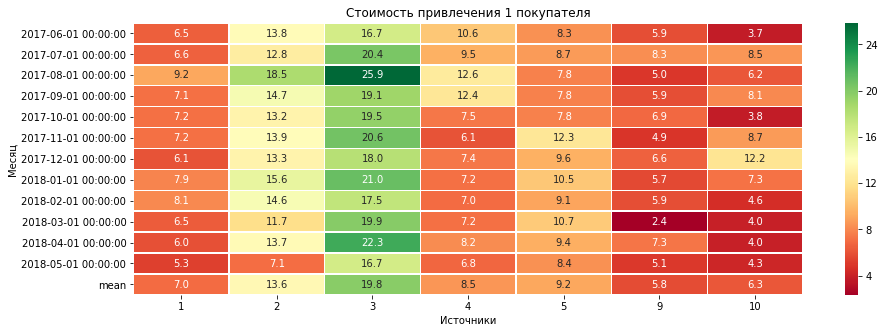

In [45]:
number_purchases = uid_first_source.pivot_table(index = 'ts_month', columns = 'Source Id', values = 'buy_session', aggfunc = 'sum')
number_purchases = number_purchases[[1, 2, 3, 4, 5, 9, 10]]

cost_one_buyer_by_sources = pd.DataFrame()
for i in range(1,11):
    try:
        cost_one_buyer_by_sources[i] = costs_pivot[i] / number_purchases[i]
    except:
        continue
cost_one_buyer_by_sources.loc['mean'] = cost_one_buyer_by_sources.mean()
cost_one_buyer_by_sources

plt.figure(figsize=(15, 5))
plt.title('Стоимость привлечения 1 покупателя')
sns.heatmap(cost_one_buyer_by_sources, annot=True, fmt=".1f", linewidths=.5, cmap = 'RdYlGn')
plt.xlabel('Источники')
plt.ylabel('Месяц')
plt.show()



In [46]:
print('Средний САС: ', cost_one_buyer_by_sources.mean().mean().round(2))

Средний САС:  10.03


Видим, что 3-й источник самый дорогой. Предпочтительние сделать акцент на более "дешевых" источниках с лучшей конверсией, например 1, 5, 10, 4 либо работать над конверсией. Изобразим изменение САС на графике


####  Рассчитаем ROMI по когортам в разрезе источников. Сравним окупаемость за одинаковые периоды жизни когорт. Построим графики, отражающие изменения метрик во времени.
Обратим внимание, что клиенты, пришедшие из разных источников, могут иметь разный LTV. 






Если сравнить среднее значение CAC=10.03 и LTV=7.56, то видно, что наши затраты на рекламу не окупаются. Давайте посмотрим возрастные когорты и посчитаем 6-месяцным LTV по источникам. 


In [47]:

cohort_report_size=buyer.groupby('first_order_month').agg({'Uid':'nunique'}).reset_index()
cohort_report_size.rename(columns={'Uid':'n_buyer'},inplace=True)
# Добавим в информацию о покупках месяц первой покупки
cohort=pd.merge(order,buyer,how='inner', on='Uid')\
.groupby(['first_order_month','order_month'])\
.agg({'Revenue':'sum'}).reset_index()

# считаем возраст каждой когорты
cohort['age_month']=((cohort['order_month']-cohort['first_order_month'])/np.timedelta64(1,'M')).round()
cohort.columns=['first_order_month','order_month','revenue','age_month']
# добавляем в когортный отчет количество покупателей в каджой когорте
# и считаем выручку на каждого покупателя
cohort_report_source=pd.merge(cohort_report_size, cohort, on='first_order_month')
cohort_report_source.head()

,first_order_month,n_buyer,order_month,revenue,age_month
0,2017-06-01,2023,2017-06-01,9557.49,0.0
1,2017-06-01,2023,2017-07-01,981.82,1.0
2,2017-06-01,2023,2017-08-01,885.34,2.0
3,2017-06-01,2023,2017-09-01,1931.30,3.0
4,2017-06-01,2023,2017-10-01,2068.58,4.0


In [48]:
cost=cost.rename(columns={'costs_month':'first_order_month'})
cohort_report_source

,first_order_month,n_buyer,order_month,revenue,age_month
0,2017-06-01,2023,2017-06-01,9557.49,0.0
1,2017-06-01,2023,2017-07-01,981.82,1.0
2,2017-06-01,2023,2017-08-01,885.34,2.0
3,2017-06-01,2023,2017-09-01,1931.30,3.0
4,2017-06-01,2023,2017-10-01,2068.58,4.0
...,...,...,...,...,...
74,2018-03-01,3533,2018-05-01,1114.87,2.0
75,2018-04-01,2276,2018-04-01,10600.69,0.0
76,2018-04-01,2276,2018-05-01,1209.92,1.0
77,2018-05-01,2988,2018-05-01,13925.76,0.0


In [49]:
cohort_report_source['first_order_month']=cohort_report_source['first_order_month'].astype('datetime64[M]')
cost['first_order_month']=cost['first_order_month'].astype('datetime64[M]')
cohort_report_source=pd.merge(cohort_report_source,cost, on='first_order_month')
cohort_report_source



,first_order_month,n_buyer,order_month,revenue,age_month,source_id,dt,costs
0,2017-06-01,2023,2017-06-01,9557.49,0.0,1,2017-06-01,75
1,2017-06-01,2023,2017-06-01,9557.49,0.0,1,2017-06-02,62
2,2017-06-01,2023,2017-06-01,9557.49,0.0,1,2017-06-03,36
3,2017-06-01,2023,2017-06-01,9557.49,0.0,1,2017-06-04,55
4,2017-06-01,2023,2017-06-01,9557.49,0.0,1,2017-06-05,57
...,...,...,...,...,...,...,...,...
16595,2018-05-01,2988,2018-05-01,13925.76,0.0,10,2018-05-27,9
16596,2018-05-01,2988,2018-05-01,13925.76,0.0,10,2018-05-28,21
16597,2018-05-01,2988,2018-05-01,13925.76,0.0,10,2018-05-29,11
16598,2018-05-01,2988,2018-05-01,13925.76,0.0,10,2018-05-30,33


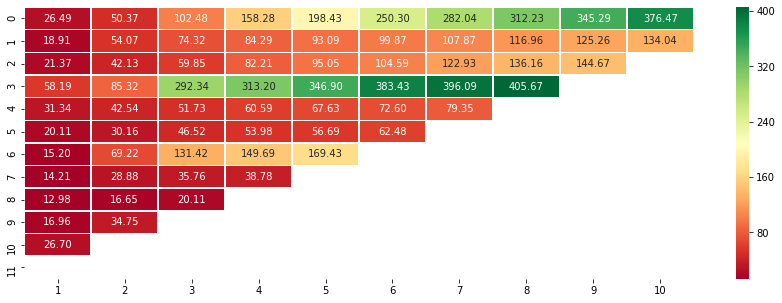

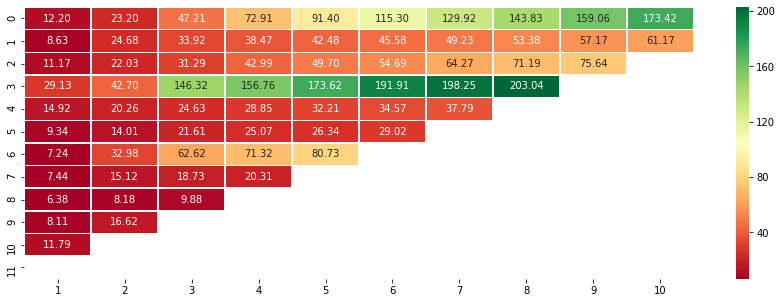

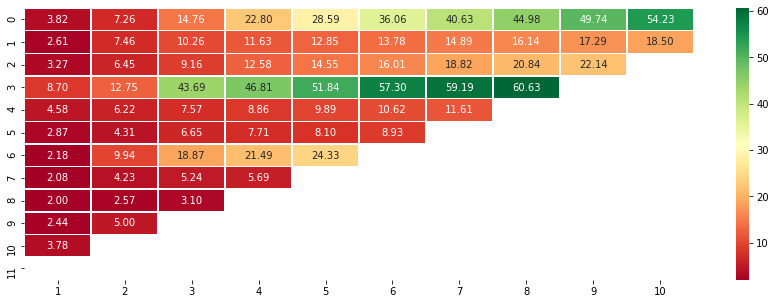

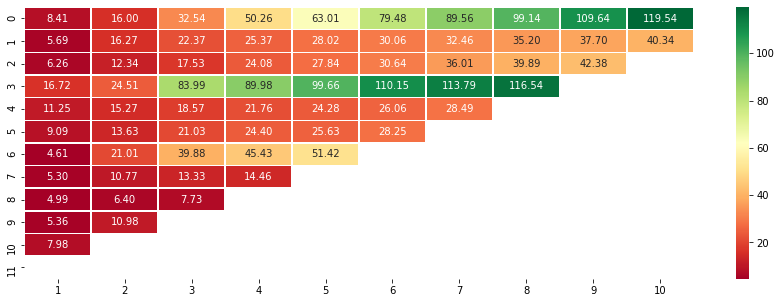

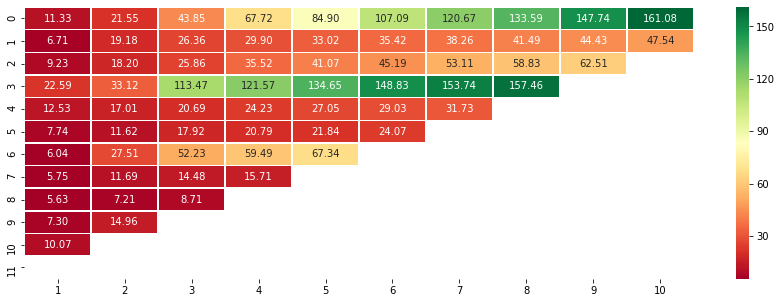

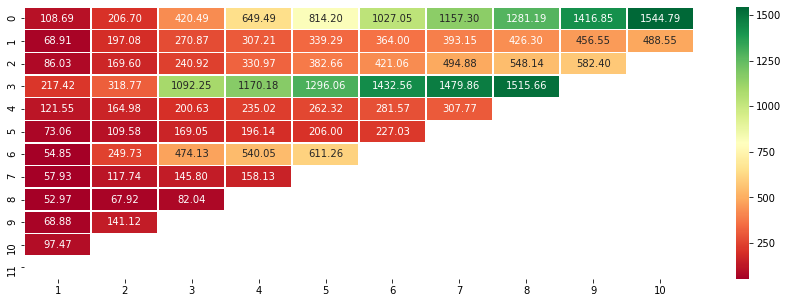

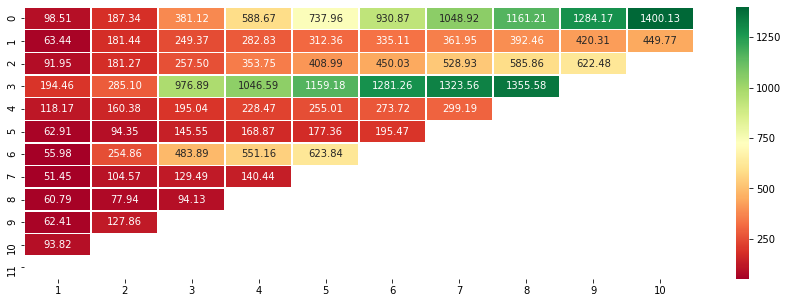

In [50]:
id_list=[1,2,3,4,5,9,10]
for id in id_list:
    ltv_1 = cohort_report_source.query('source_id == @id').pivot_table(index='first_order_month',
    columns='age_month',
    values='revenue',
    aggfunc='sum'
    ).reset_index()
    ltv_2 = cohort_report_source.query('source_id == @id').pivot_table(index='first_order_month',
    columns='age_month',
    values='n_buyer',
    aggfunc='sum'
    ).reset_index()
    ltv= pd.DataFrame()
    for i in range(1,11):
        try:
            ltv[i] = ltv_1[i] / ltv_2[i]
        except:
            continue
    cac_1=cohort_report_source.query('source_id == @id').pivot_table(index='first_order_month',
    columns='age_month',
    values='costs',
    aggfunc='sum'
    ).reset_index()
    cac_2=cohort_report_source.query('source_id == @id').pivot_table(index='first_order_month',
    columns='age_month',
    values='n_buyer',
    aggfunc='sum'
    ).reset_index()
    cac = pd.DataFrame()
    for i in range(1,11):
        try:
            cac[i] = cac_1[i] / cac_2[i]
        except:
            continue
    romi = pd.DataFrame()
    for i in range(1,11):
        try:
            romi[i] = ltv[i] / cac[i]
        except:
            continue
    plt.figure(figsize=(15, 5))
    sns.heatmap(romi.cumsum(axis=1), annot=True, fmt=".2f", linewidths=.5, cmap = 'RdYlGn' )
    plt.show()
    




я сделала так, для каждого источника решила посчтитать ROMI, у меня есть общая таблица cohort_report_source, где есть информация о затратах на рекламу, количетсво потраченных клиентом денег, месяц первой покупки и так далее. В рассчете ROMI я создаю таблицу ltv_1, где считаю прибыль по этому источнику для каждой гогорты и распределение по месяцам, дальше считаю ltv_2, где считаю кол-ло пользователей, делю ltv_1 на ltv_2 получаю ltv для каждого источника по когортам и месяцам их жизни. Далее считаю cac_1, где считаю затраты по источнику так же по месяцам и потом делю на количество пользователей. Дальше делю LTV на CAC с помощью цикла for и получаю распределение по кжадому источнику. Не знаю почему значения получились такими большими но! видно, что наиболее окупаемые когорты выбраны правильно - это первая и четвертая, к ним можно еще добавить седьмую, но показатели у нее немного ниже.





### Сформулируем выводы и рекомендации
#### Определим источники трафика, на которые маркетологам стоит делать упор. 

из графика ltv можно  предположить, что затраты на маркетинг окупились в первой( на 6й месяц)  и четвертой( на 3-й месяц) когорте, тогда логично предположить, что чтобы стоимость привлечения окупалась уже через полгода, необходимо, чтобы стоимость привлечения 1 клиента не была выше 8 у.е.


Марктелогам я бы предложила сделать упор на 1, 5, 10 и 4 источники, так как там наблюдается набиольшая конверсия и по затратам они не очень дорого обходяться. Либо нужно понять почему конверсия в 3 и 2 источниках хромает и постараться увеличить ее всеми возможными способами, ведь 3 ресурс очень популярен среди пользователей и может увеличить доход сайта, если возрастет конверсия. 


#### Опишем выводы, которые мы сделали после подсчёта метрик каждого вида: маркетинговых, продуктовых и метрик электронной коммерции;

После подсчета всех метрик можно сделать выводы, что популярность сайта падает и им пользуются все больше и больше людей, повышенную активность ближе к зиме можно назвать выбросом или привязать к сезонности, так как клиенты, пришедшие в это время не часто возвращаются, чтобы совершить еще покупки. Сервисом пользуются достаточно редко, покупки в основном совершаются при первом посещении, причем в течении 1 минуты после захода.Средний чек 1 покупки - 4,8 у.е.
Пользователи неохотно возвращаются на сайт и меньше всего их летом, потому что в это время театры, кино и концерты уходят на второй план.
В среднем пользователи совершают чуть больше одной покупки.
Хочется еще заметить, что многие маркетинговые вложения не окупаются даже больше, чем за пол года. На это стоит обратить внимание маркетологам и попытаться понять, что именно не так с уже существующими стратегиями продвижения, как можно улучшить конверсию по популярным среди пользователей источникам и может быть вложить больше денег в менее популярные источники с хорошей конверсией. 
####  Подведем итоги когортного анализа. Определим самые перспективные для компании когорты клиентов;

Самыми перспективными когортами для компании я бы выделила 1-ую(2017-06) и 4 когорту( 2017-09), потому что именно в этих когортах показатели LTV достаточно хорошие( и предполагаю, что в этих когортах окупились затраты на маркетинг), так же в 1-ой когорте хороший показатель Retention Rate и пользователи этой когорты совершают наибольшее число покупок. Когорта 4 выделяется среди других по количеству выручки, может быть это связано с особенностью рекламной компании. У них хороший средний чек и высокие показатели  LTV. 

В целом все лучше чем могло показаться на первый взгляд. Мы провели анализ и теперь можно разработать план по улучшению работы нашего сайта. Мы выяснили, на какие когорты лучше сделат акцент, какие рекламные источники выгоднее всего продвигать и теперь есть шанс, что больше затрат на рекламные источники окупится. 


